- [Experimento 1: peppers](#Experimento-1:-peppers)
- [Experimento 2: boat](#Experimento-2:-boat)
- [Experimento 3: baboon](#Experimento-3:-baboon)

Vamos a estudiar cómo se comportan los grafos de visibilidad de imagen cuando añadimos ruido a la imagen. Para ello, vamos a comparar diferentes filtros de visibilidad de las imágenes con y sin ruido además del ruido por separado.

In [1]:
from src.visibility.image.ivg import IVG
from src.utils.Utilities import *
from PIL import Image
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt

In [2]:
def flatten(xss):
    return [x for xs in xss for x in xs]

def show_images(images):
    f, plts = plt.subplots(1,3)
    f.set_figwidth(15)
    for i in range(3):
        plts[i].imshow(images[i], cmap='gray', vmin=0, vmax=255)
        plts[i].axis('off')

def show_filters(filters):
    f, plts = plt.subplots(1,3)
    f.set_figwidth(15)
    for i in range(3):
        plts[i].imshow(filters[i], cmap='gray')
        plts[i].axis('off')

def show_deg_hist(deg):
    f, plts = plt.subplots(1,3)
    f.set_figwidth(15)
    deg_hist = [flatten(mat) for mat in deg]
    for i in range(3):
        plts[i].hist(deg_hist[i], bins=max(deg_hist[i]), density=True)
        plts[i].set_xlim([0, max(flatten(deg_hist))])

def show_clust_hist(clust):
    f, plts = plt.subplots(1,3)
    f.set_figwidth(15)
    clust_hist = [flatten(mat) for mat in clust]
    for i in range(3):
        plts[i].hist(clust_hist[i], bins=50, density=True)
        plts[i].set_xlim([0, max(flatten(clust_hist))])

def show_knn_hist(knn):
    f, plts = plt.subplots(1,3)
    f.set_figwidth(15)
    knn_hist = [flatten(mat) for mat in knn]
    for i in range(3):
        plts[i].hist(knn_hist[i], bins=25, density=True)
        plts[i].set_xlim([0, max(flatten(knn_hist))])
        plts[i].ticklabel_format(axis='x', style='sci', scilimits=(0,0))

## Experimento 1: peppers

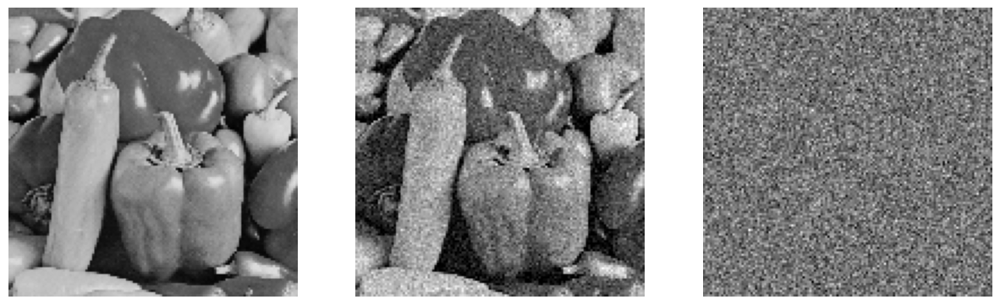

In [3]:
peppers = np.array(Image.open('assets/ivg/peppers128.png').convert("L")).tolist()
n = len(peppers)
n = len(peppers)
noise = image_noise(n)
peppers_noise = add_noise(peppers, noise, 0.3)
peppers_images = [peppers, peppers_noise, noise]
show_images(peppers_images)
plt.savefig('assets/ivg/peppers_noise.jpg')

### IVG

In [4]:
peppers_ivgs = [IVG(im) for im in peppers_images]

In [5]:
deg = [degree_matrix(ivg) for ivg in peppers_ivgs] # grados
clust = [clustering_matrix(ivg) for ivg in peppers_ivgs] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in peppers_ivgs] # average nearest-neighbour degree

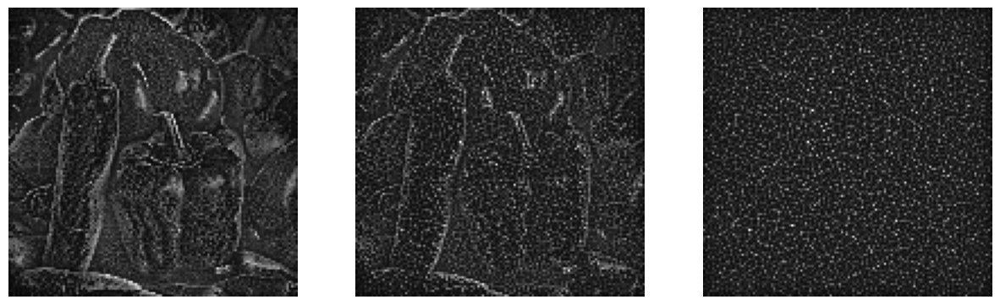

In [6]:
show_filters(deg)
plt.savefig('assets/ivg/peppers_ivg_deg.jpg')

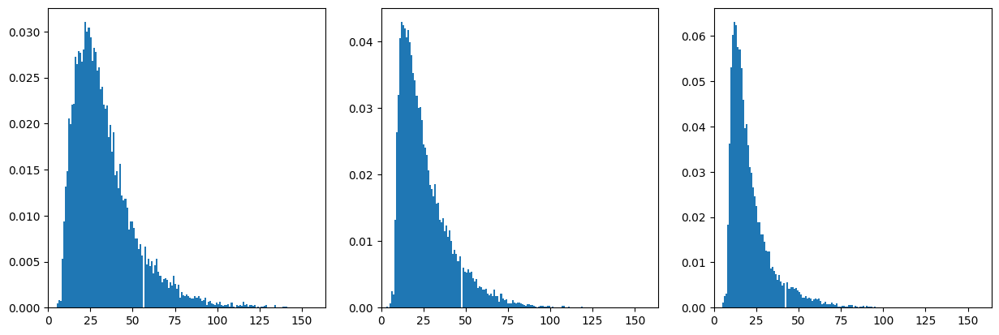

In [7]:
show_deg_hist(deg)
plt.savefig('assets/ivg/peppers_ivg_deg_hist.jpg')

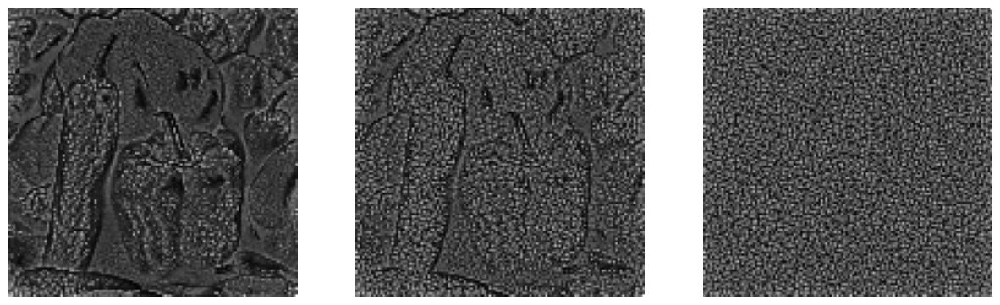

In [8]:
show_filters(clust)
plt.savefig('assets/ivg/peppers_ivg_clust.jpg')

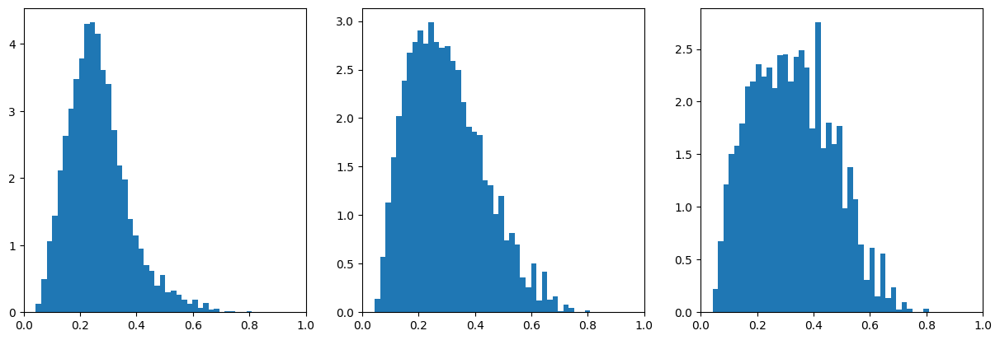

In [9]:
show_clust_hist(clust)
plt.savefig('assets/ivg/peppers_ivg_clust_hist.jpg')

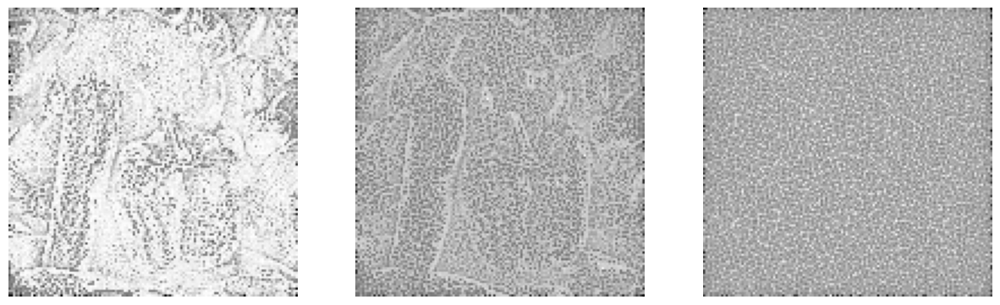

In [10]:
show_filters(knn)
plt.savefig('assets/ivg/peppers_ivg_knn.jpg')

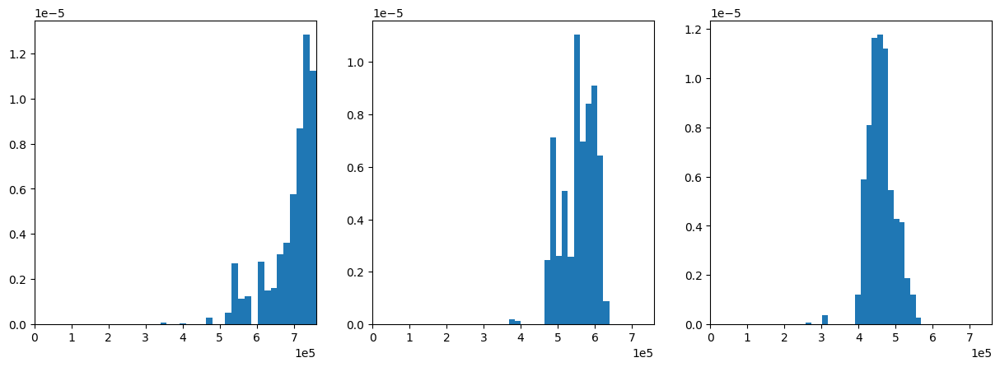

In [11]:
show_knn_hist(knn)
plt.savefig('assets/ivg/peppers_ivg_knn_hist.jpg')

### IHVG

In [12]:
peppers_ihvgs = [IVG(image, horizontal=True) for image in peppers_images]

In [13]:
deg = [degree_matrix(ivg) for ivg in peppers_ihvgs] # grados
clust = [clustering_matrix(ivg) for ivg in peppers_ihvgs] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in peppers_ihvgs] # average nearest-neighbour degree

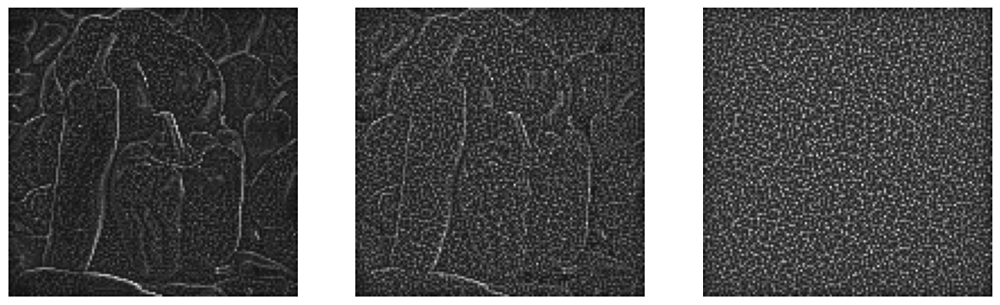

In [14]:
show_filters(deg)
plt.savefig('assets/ivg/peppers_ihvg_deg.jpg')

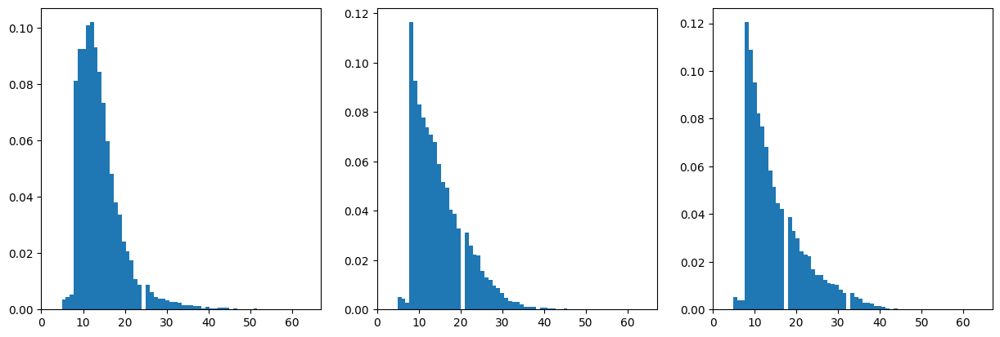

In [15]:
show_deg_hist(deg)
plt.savefig('assets/ivg/peppers_ihvg_deg_hist.jpg')

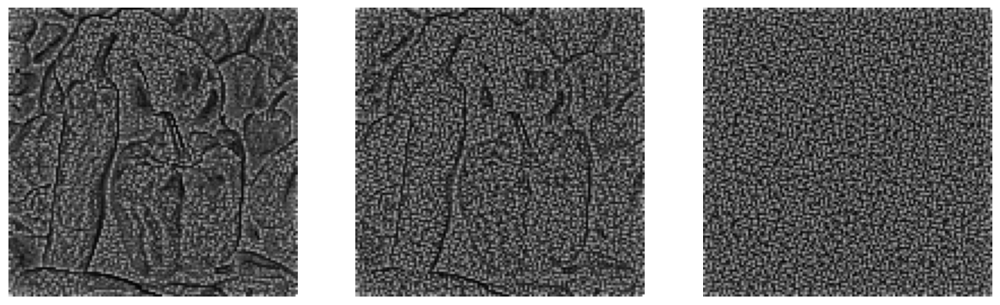

In [16]:
show_filters(clust)
plt.savefig('assets/ivg/peppers_ihvg_clust.jpg')

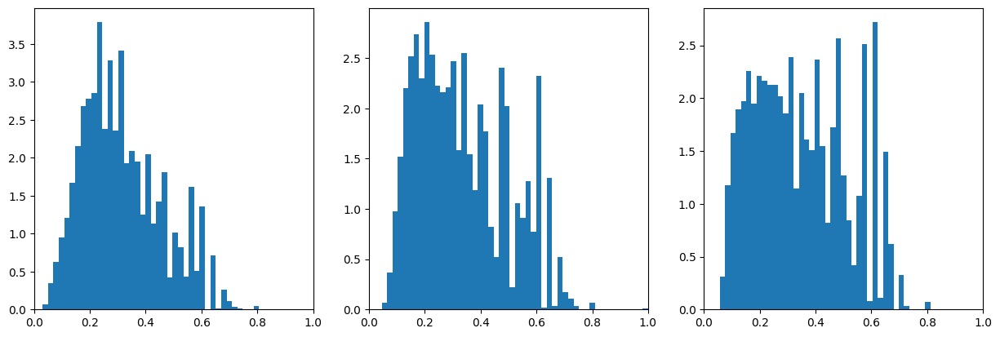

In [17]:
show_clust_hist(clust)
plt.savefig('assets/ivg/peppers_ihvg_clust_hist.jpg')

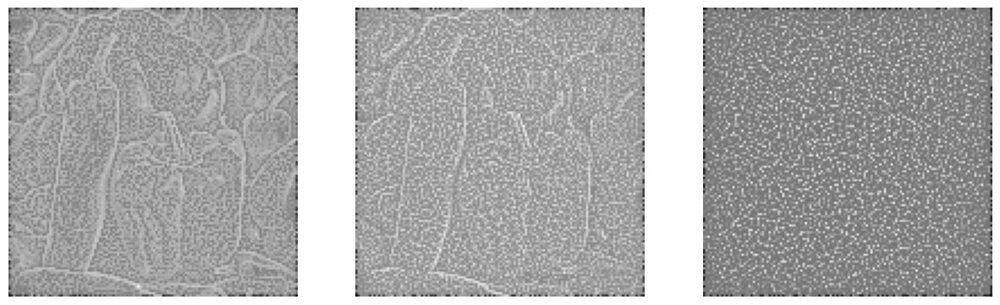

In [18]:
show_filters(knn)
plt.savefig('assets/ivg/peppers_ihvg_knn.jpg')

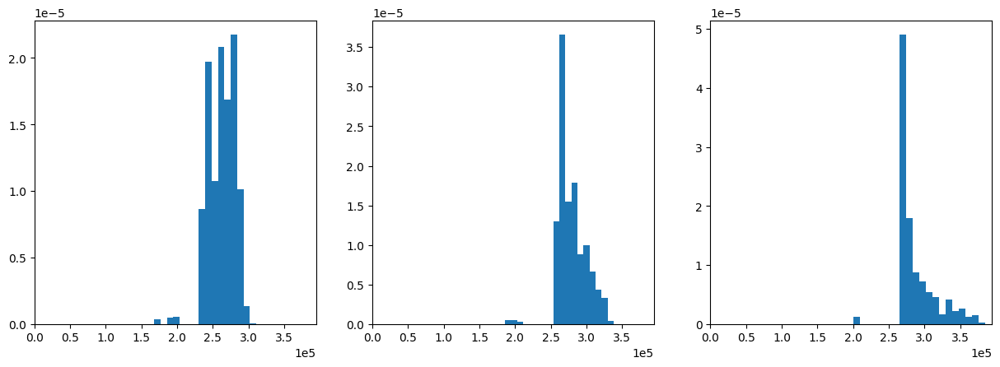

In [19]:
show_knn_hist(knn)
plt.savefig('assets/ivg/peppers_ihvg_knn_hist.jpg')

### IVG diagonales adicionales

In [20]:
peppers_ivgds = [IVG(image, diags=True) for image in peppers_images]

In [21]:
deg = [degree_matrix(ivg) for ivg in peppers_ivgds] # grados
clust = [clustering_matrix(ivg) for ivg in peppers_ivgds] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in peppers_ivgds] # average nearest-neighbour degree

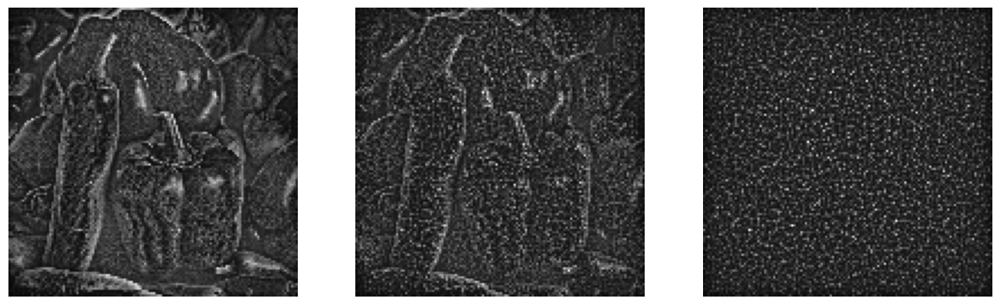

In [22]:
show_filters(deg)
plt.savefig('assets/ivg/peppers_ivgd_deg.jpg')

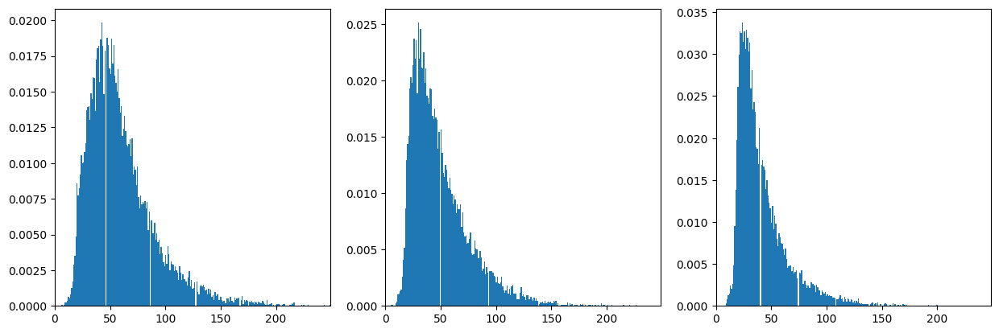

In [23]:
show_deg_hist(deg)
plt.savefig('assets/ivg/peppers_ivgd_deg_hist.jpg')

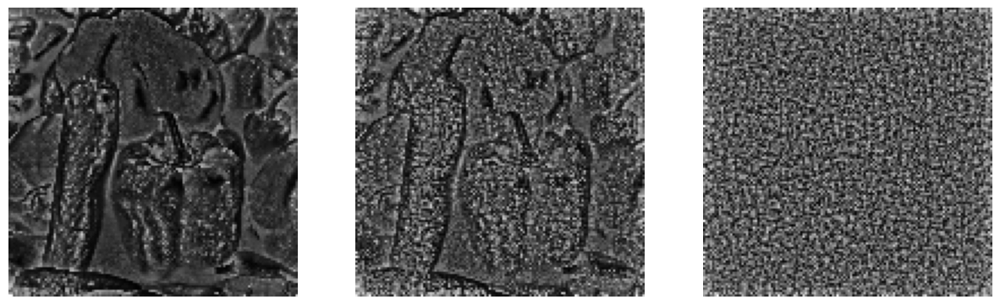

In [24]:
show_filters(clust)
plt.savefig('assets/ivg/peppers_ivgd_clust.jpg')

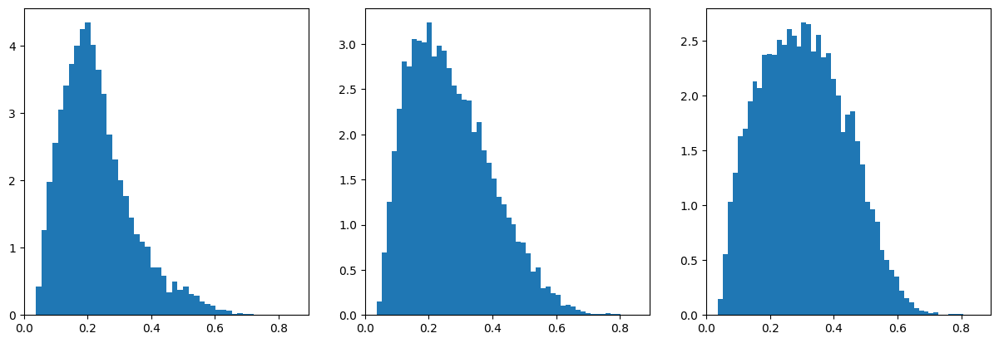

In [25]:
show_clust_hist(clust)
plt.savefig('assets/ivg/peppers_ivgd_clust_hist.jpg')

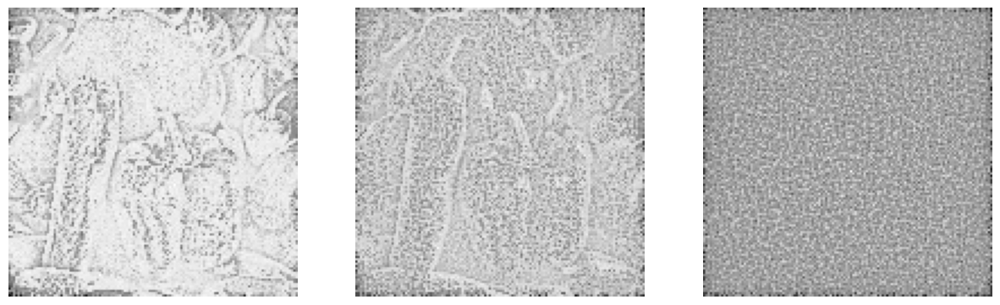

In [26]:
show_filters(knn)
plt.savefig('assets/ivg/peppers_ivgd_knn.jpg')

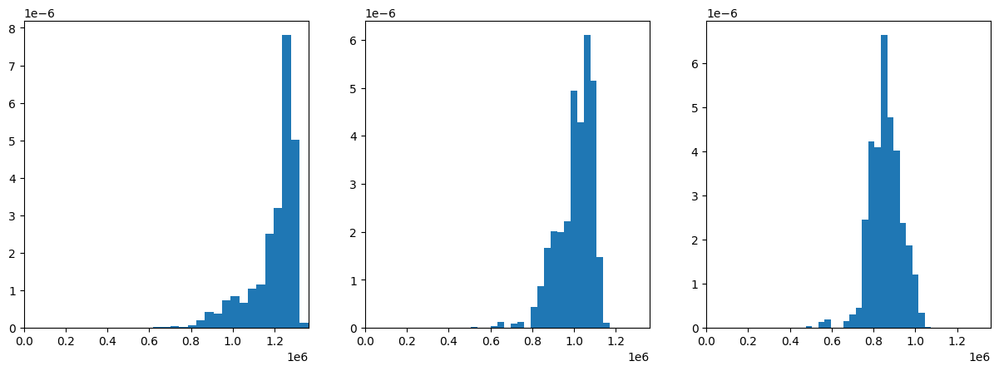

In [27]:
show_knn_hist(knn)
plt.savefig('assets/ivg/peppers_ivgd_knn_hist.jpg')

### IHVG diagonales adicionales

In [28]:
peppers_ihvgds = [IVG(image, horizontal=True, diags=True) for image in peppers_images]

In [29]:
deg = [degree_matrix(ivg) for ivg in peppers_ihvgds] # grados
clust = [clustering_matrix(ivg) for ivg in peppers_ihvgds] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in peppers_ihvgds] # average nearest-neighbour degree

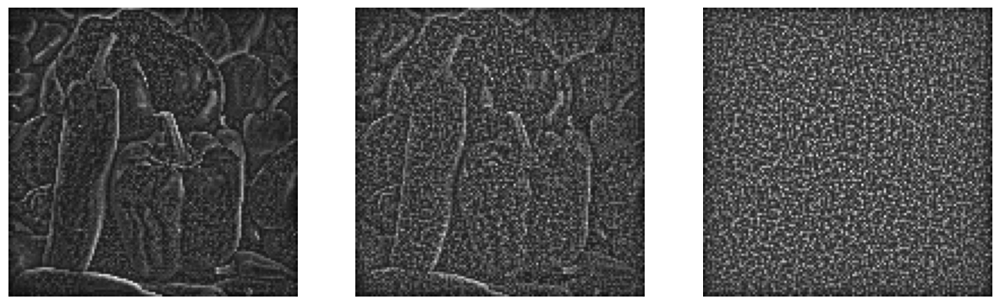

In [30]:
show_filters(deg)
plt.savefig('assets/ivg/peppers_ihvgd_deg.jpg')

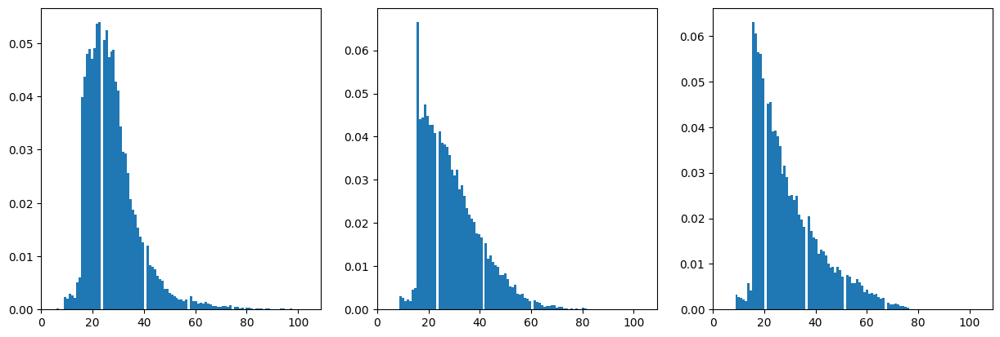

In [31]:
show_deg_hist(deg)
plt.savefig('assets/ivg/peppers_ihvgd_deg_hist.jpg')

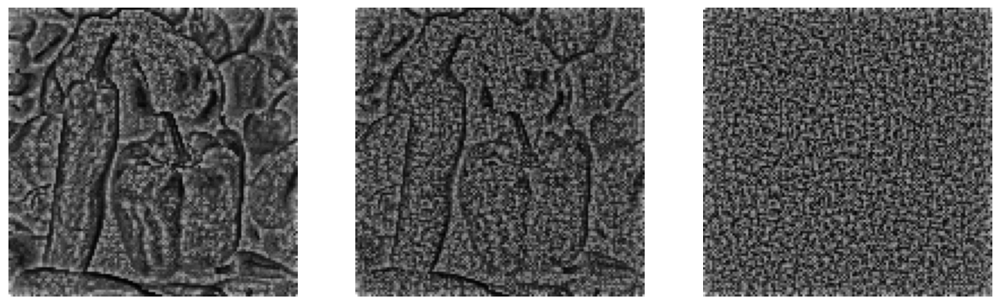

In [32]:
show_filters(clust)
plt.savefig('assets/ivg/peppers_ihvgd_clust.jpg')

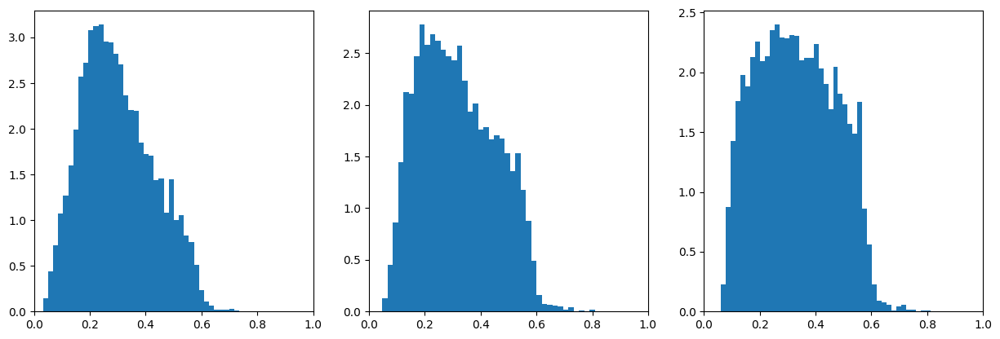

In [33]:
show_clust_hist(clust)
plt.savefig('assets/ivg/peppers_ihvgd_clust_hist.jpg')

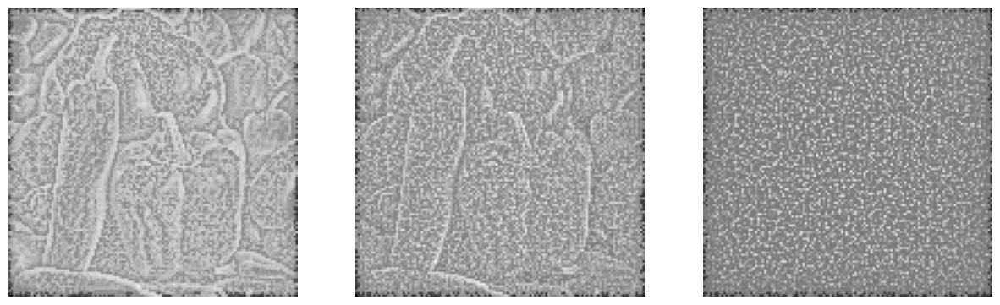

In [34]:
show_filters(knn)
plt.savefig('assets/ivg/peppers_ihvgd_knn.jpg')

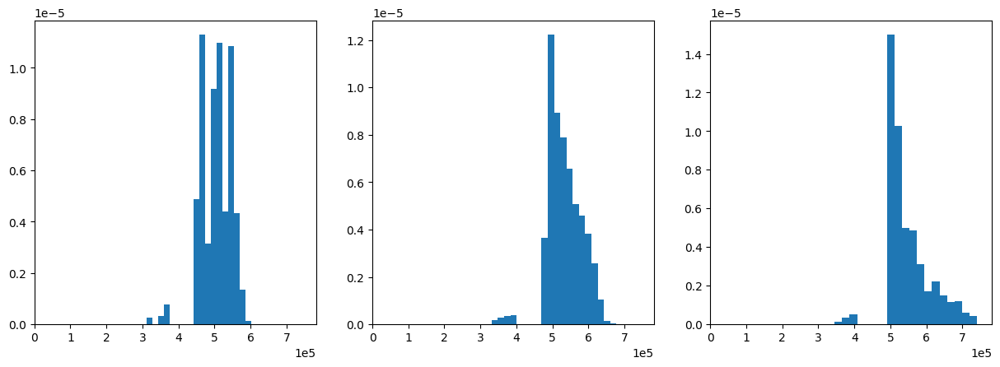

In [35]:
show_knn_hist(knn)
plt.savefig('assets/ivg/peppers_ihvgd_knn_hist.jpg')

## Experimento 2: boat

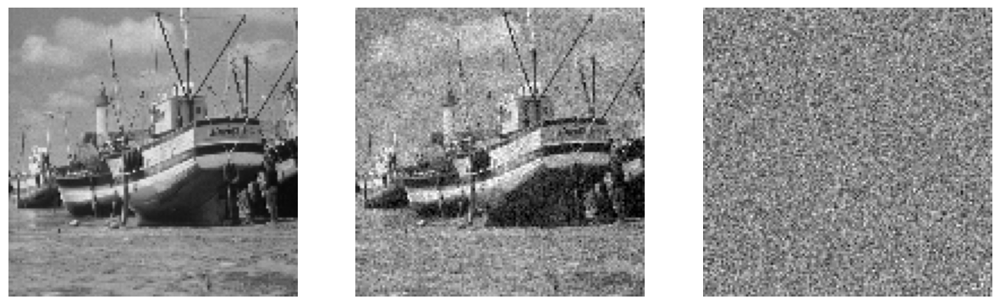

In [36]:
boat = np.array(Image.open('assets/ivg/boat128.png').convert("L")).tolist()
n = len(boat)
n = len(boat)
noise = image_noise(n)
boat_noise = add_noise(boat, noise, 0.3)
boat_images = [boat, boat_noise, noise]
show_images(boat_images)
plt.savefig('assets/ivg/boat_noise.jpg')

### IVG

In [37]:
boat_ivgs = [IVG(im) for im in boat_images]

In [38]:
deg = [degree_matrix(ivg) for ivg in boat_ivgs] # grados
clust = [clustering_matrix(ivg) for ivg in boat_ivgs] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in boat_ivgs] # average nearest-neighbour degree

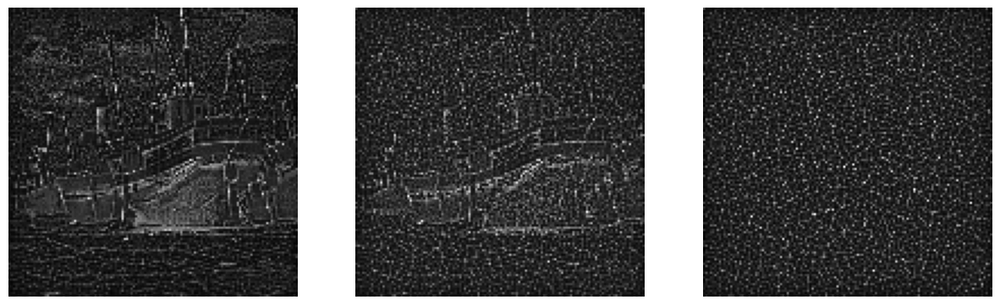

In [39]:
show_filters(deg)
plt.savefig('assets/ivg/boat_ivg_deg.jpg')

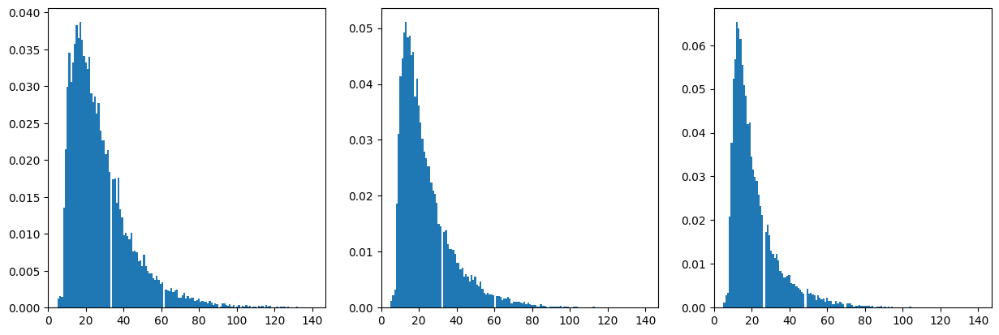

In [40]:
show_deg_hist(deg)
plt.savefig('assets/ivg/boat_ivg_deg_hist.jpg')

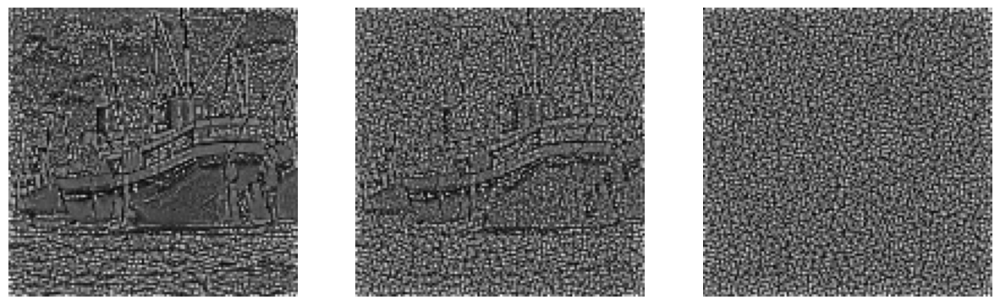

In [41]:
show_filters(clust)
plt.savefig('assets/ivg/boat_ivg_clust.jpg')

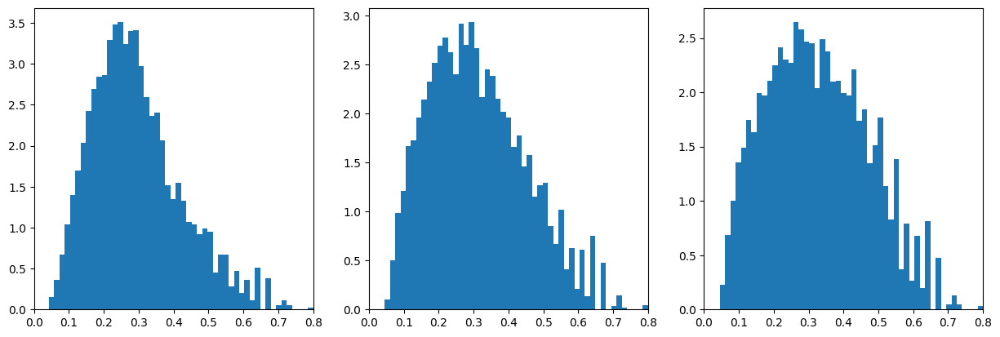

In [42]:
show_clust_hist(clust)
plt.savefig('assets/ivg/boat_ivg_clust_hist.jpg')

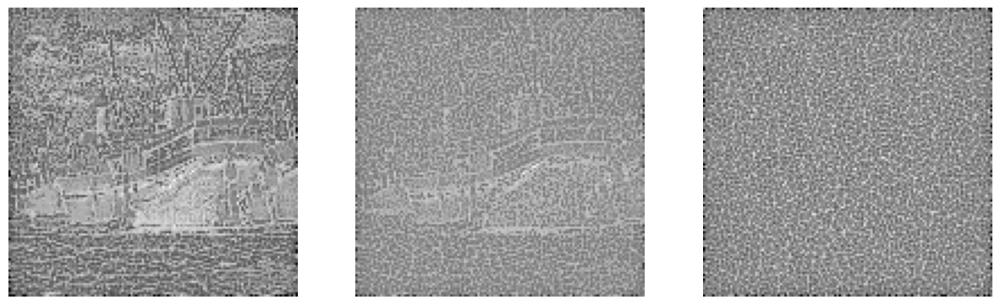

In [43]:
show_filters(knn)
plt.savefig('assets/ivg/boat_ivg_knn.jpg')

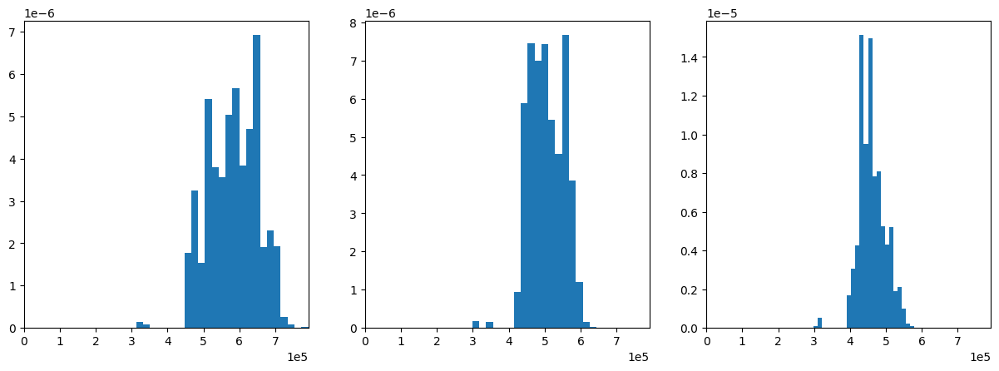

In [44]:
show_knn_hist(knn)
plt.savefig('assets/ivg/boat_ivg_knn_hist.jpg')

### IHVG

In [45]:
boat_ihvgs = [IVG(image, horizontal=True) for image in boat_images]

In [46]:
deg = [degree_matrix(ivg) for ivg in boat_ihvgs] # grados
clust = [clustering_matrix(ivg) for ivg in boat_ihvgs] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in boat_ihvgs] # average nearest-neighbour degree

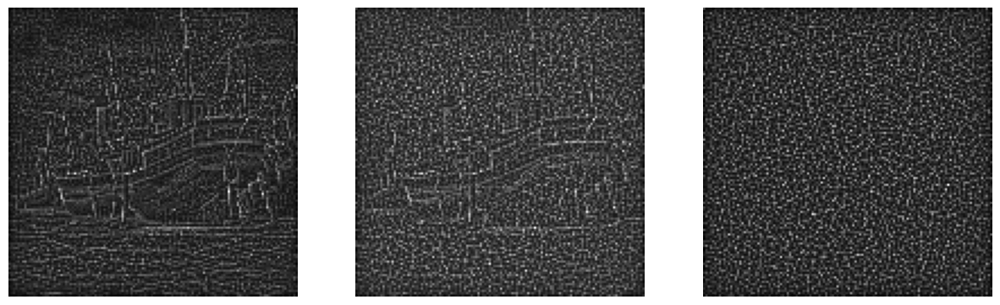

In [47]:
show_filters(deg)
plt.savefig('assets/ivg/boat_ihvg_deg.jpg')

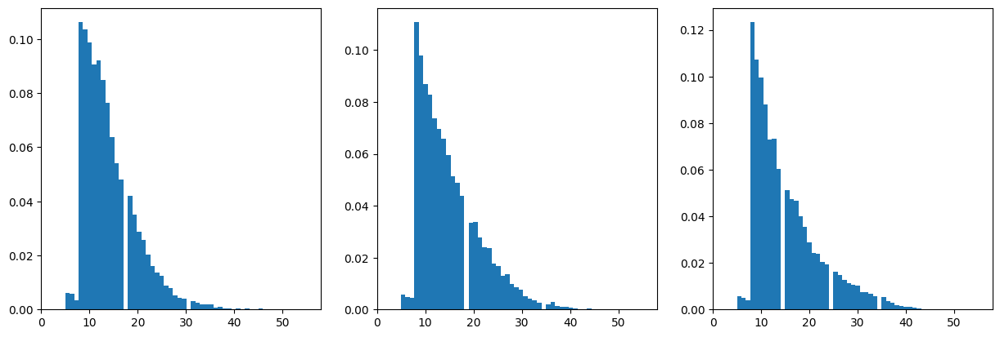

In [48]:
show_deg_hist(deg)
plt.savefig('assets/ivg/boat_ihvg_deg_hist.jpg')

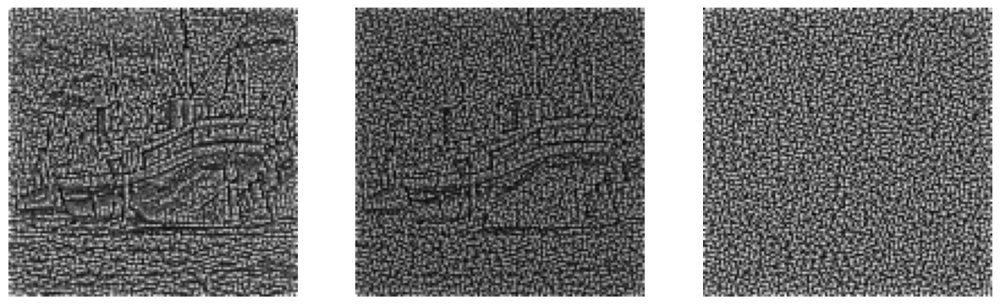

In [49]:
show_filters(clust)
plt.savefig('assets/ivg/boat_ihvg_clust.jpg')

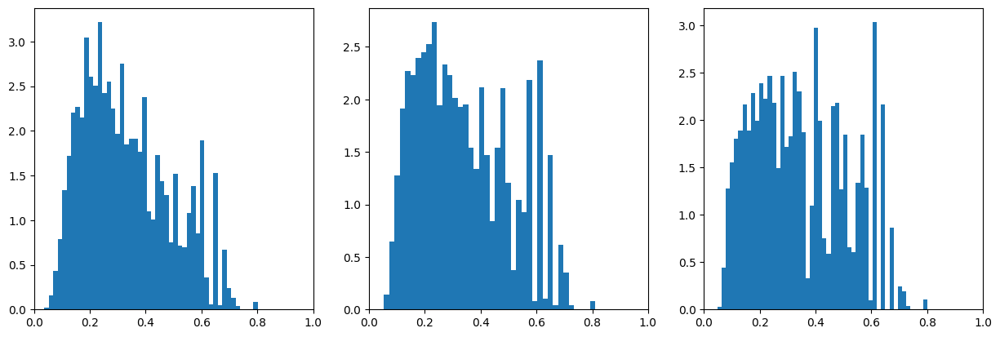

In [50]:
show_clust_hist(clust)
plt.savefig('assets/ivg/boat_ihvg_clust_hist.jpg')

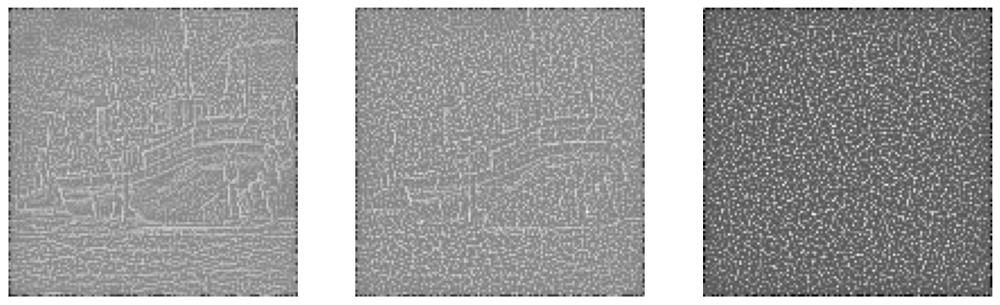

In [51]:
show_filters(knn)
plt.savefig('assets/ivg/boat_ihvg_knn.jpg')

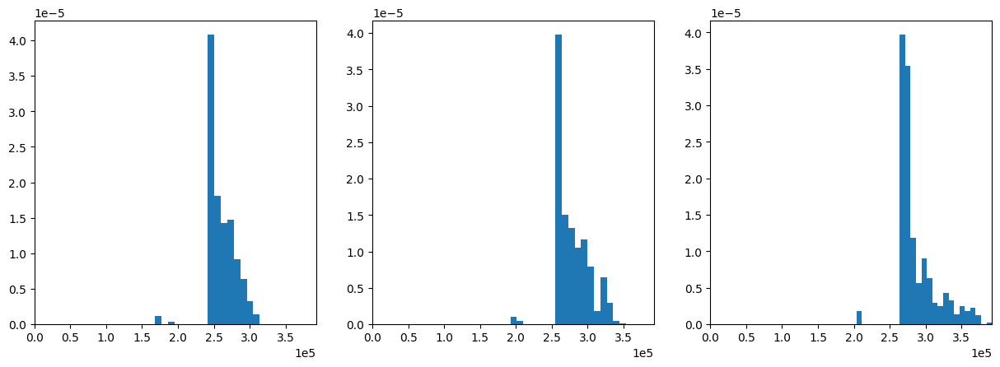

In [52]:
show_knn_hist(knn)
plt.savefig('assets/ivg/boat_ihvg_knn_hist.jpg')

### IVG diagonales adicionales

In [53]:
boat_ivgds = [IVG(image, diags=True) for image in boat_images]

In [54]:
deg = [degree_matrix(ivg) for ivg in boat_ivgds] # grados
clust = [clustering_matrix(ivg) for ivg in boat_ivgds] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in boat_ivgds] # average nearest-neighbour degree

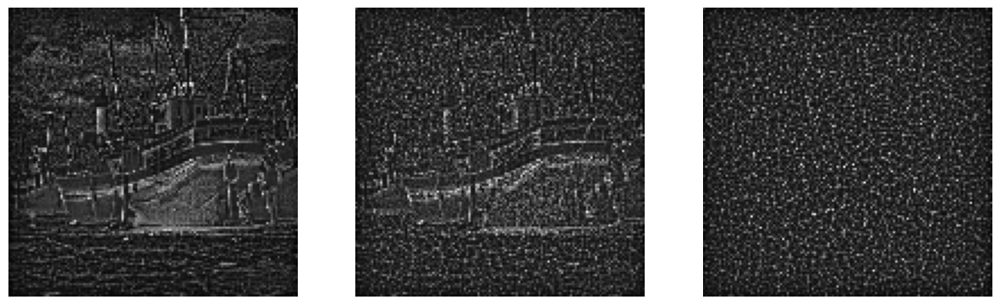

In [55]:
show_filters(deg)
plt.savefig('assets/ivg/boat_ivgd_deg.jpg')

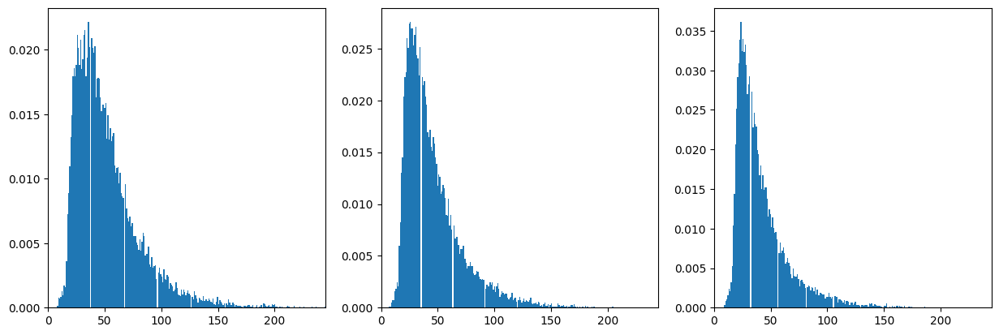

In [56]:
show_deg_hist(deg)
plt.savefig('assets/ivg/boat_ivgd_deg_hist.jpg')

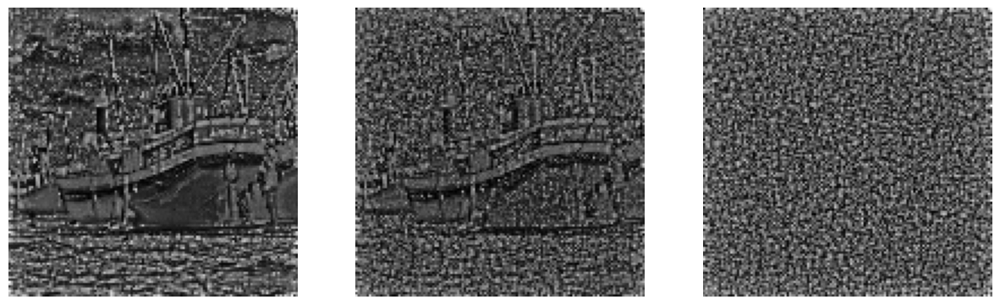

In [57]:
show_filters(clust)
plt.savefig('assets/ivg/boat_ivgd_clust.jpg')

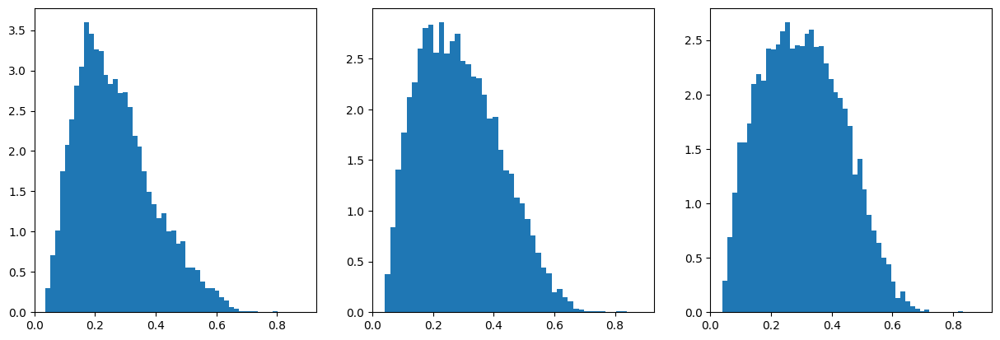

In [58]:
show_clust_hist(clust)
plt.savefig('assets/ivg/boat_ivgd_clust_hist.jpg')

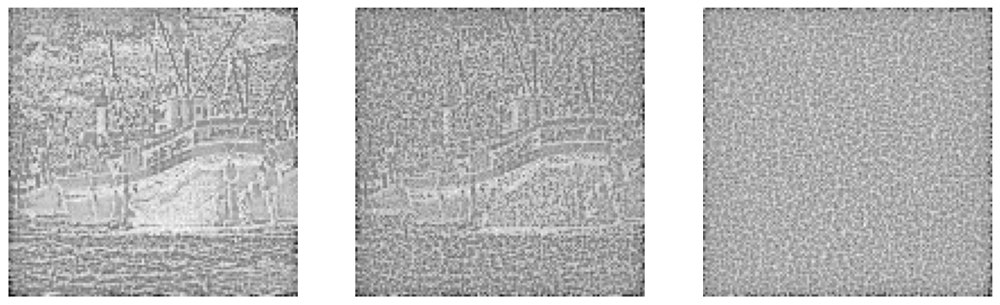

In [59]:
show_filters(knn)
plt.savefig('assets/ivg/boat_ivgd_knn.jpg')

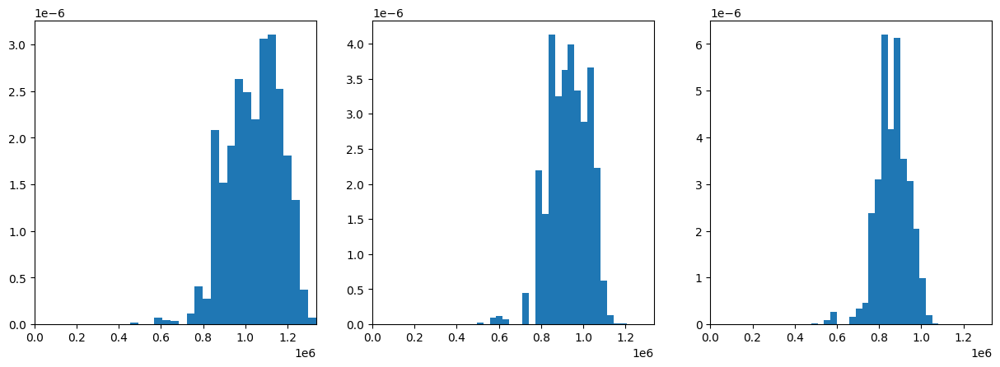

In [60]:
show_knn_hist(knn)
plt.savefig('assets/ivg/boat_ivgd_knn_hist.jpg')

### IHVG diagonales adicionales

In [61]:
boat_ihvgds = [IVG(image, horizontal=True, diags=True) for image in boat_images]

In [62]:
deg = [degree_matrix(ivg) for ivg in boat_ihvgds] # grados
clust = [clustering_matrix(ivg) for ivg in boat_ihvgds] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in boat_ihvgds] # average nearest-neighbour degree

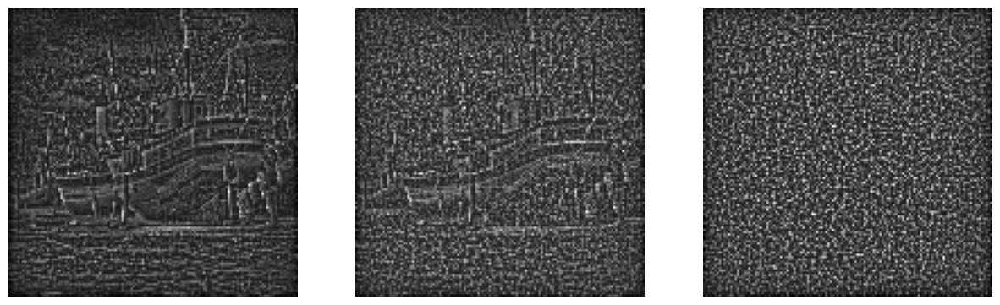

In [63]:
show_filters(deg)
plt.savefig('assets/ivg/boat_ihvgd_deg.jpg')

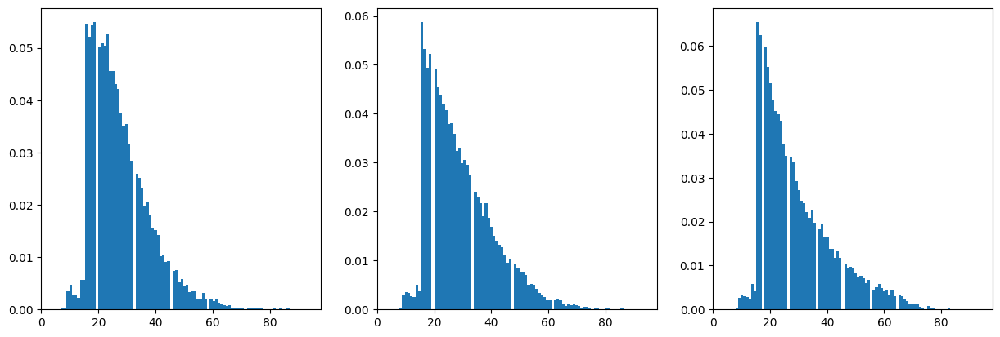

In [64]:
show_deg_hist(deg)
plt.savefig('assets/ivg/boat_ihvgd_deg_hist.jpg')

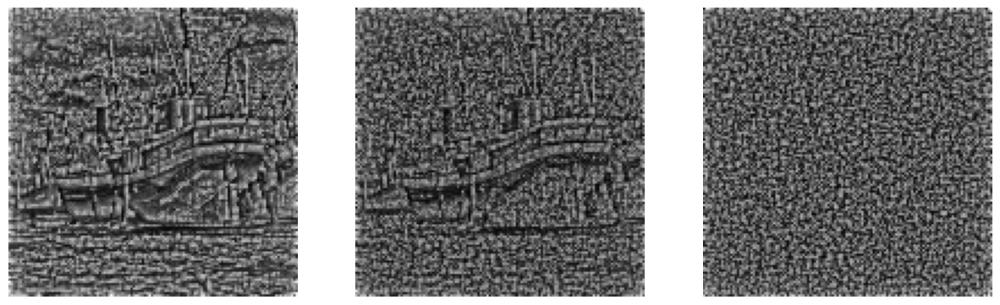

In [65]:
show_filters(clust)
plt.savefig('assets/ivg/boat_ihvgd_clust.jpg')

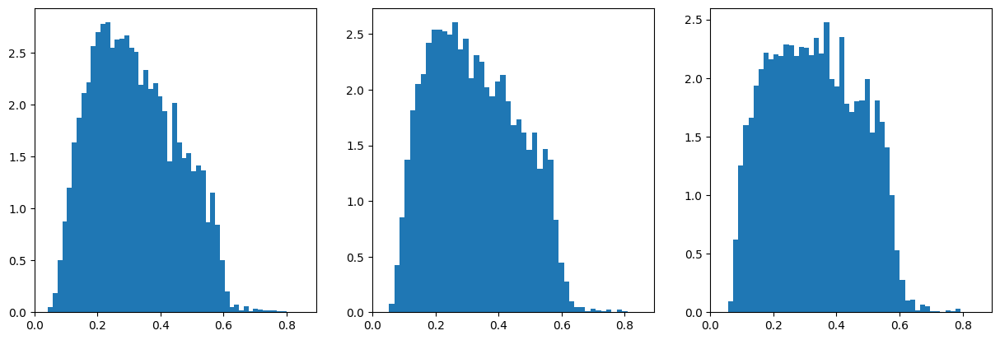

In [66]:
show_clust_hist(clust)
plt.savefig('assets/ivg/boat_ihvgd_clust_hist.jpg')

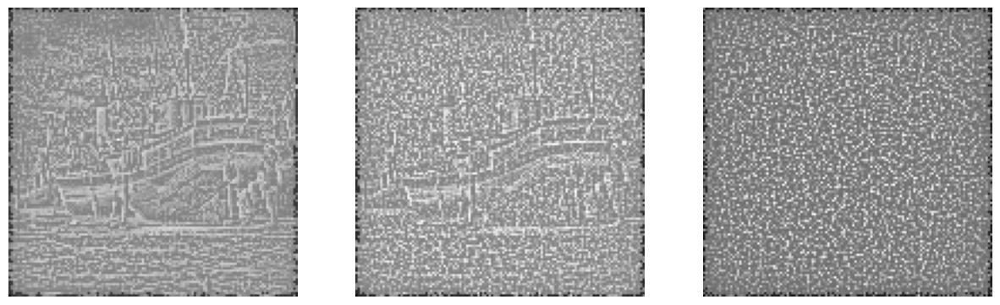

In [67]:
show_filters(knn)
plt.savefig('assets/ivg/boat_ihvgd_knn.jpg')

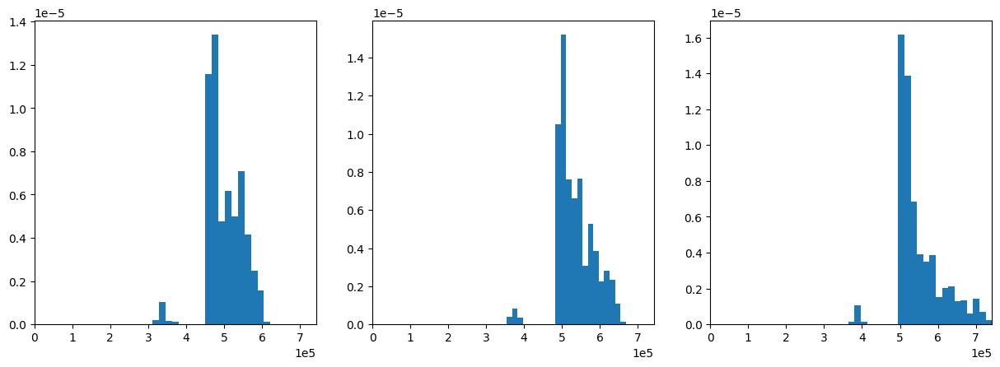

In [68]:
show_knn_hist(knn)
plt.savefig('assets/ivg/boat_ihvgd_knn_hist.jpg')

## Experimento 3: baboon

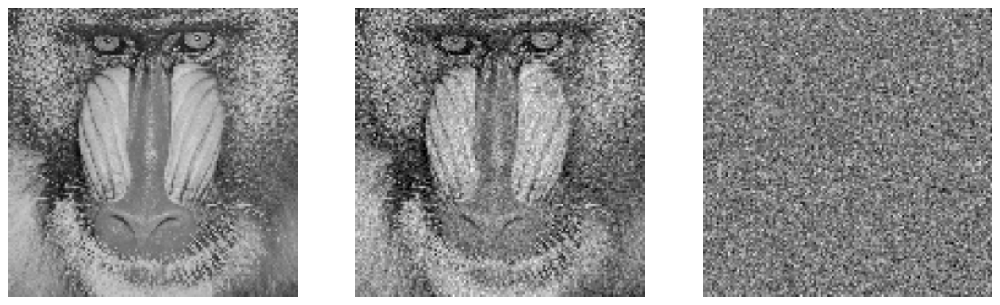

In [69]:
baboon = np.array(Image.open('assets/ivg/baboon128.png').convert("L")).tolist()
n = len(baboon)
n = len(baboon)
noise = image_noise(n)
baboon_noise = add_noise(baboon, noise, 0.3)
baboon_images = [baboon, baboon_noise, noise]
show_images(baboon_images)
plt.savefig('assets/ivg/baboon_noise.jpg')

### IVG

In [70]:
baboon_ivgs = [IVG(im) for im in baboon_images]

In [71]:
deg = [degree_matrix(ivg) for ivg in baboon_ivgs] # grados
clust = [clustering_matrix(ivg) for ivg in baboon_ivgs] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in baboon_ivgs] # average nearest-neighbour degree

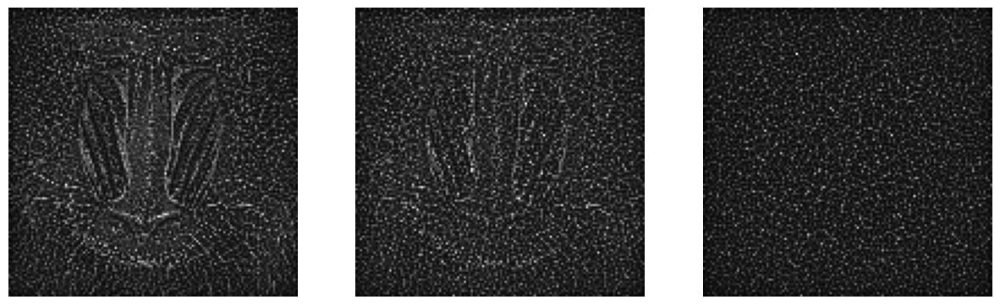

In [72]:
show_filters(deg)
plt.savefig('assets/ivg/baboon_ivg_deg.jpg')

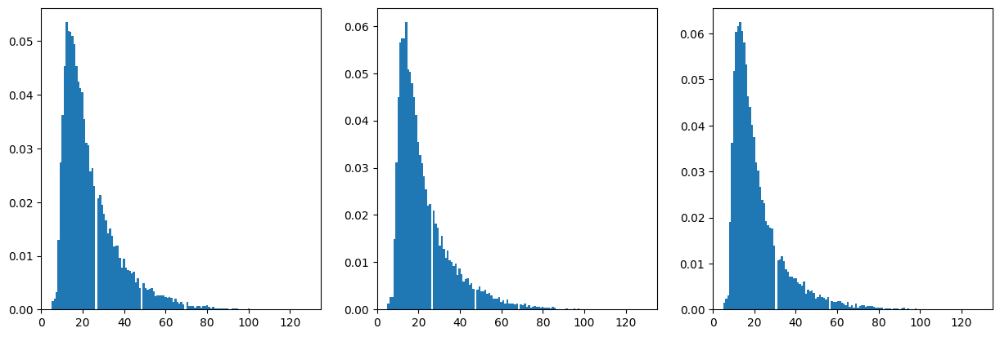

In [73]:
show_deg_hist(deg)
plt.savefig('assets/ivg/baboon_ivg_deg_hist.jpg')

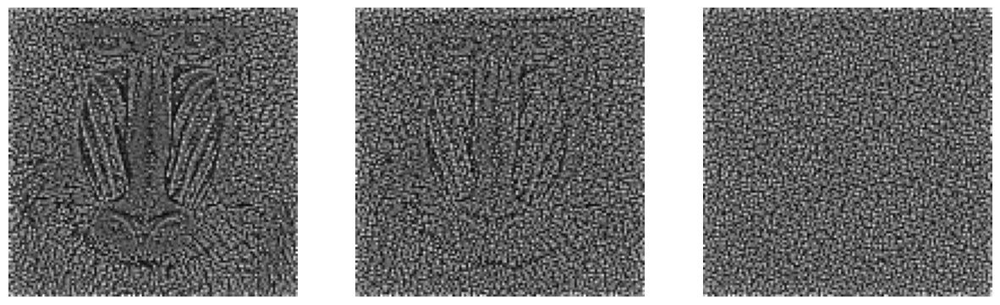

In [74]:
show_filters(clust)
plt.savefig('assets/ivg/baboon_ivg_clust.jpg')

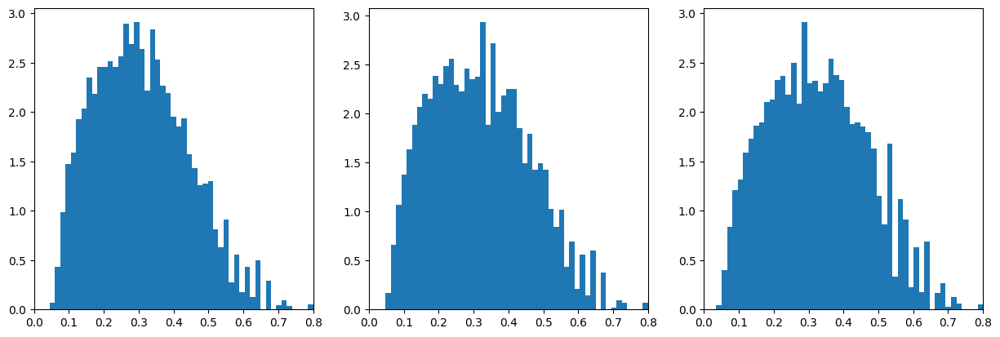

In [75]:
show_clust_hist(clust)
plt.savefig('assets/ivg/baboon_ivg_clust_hist.jpg')

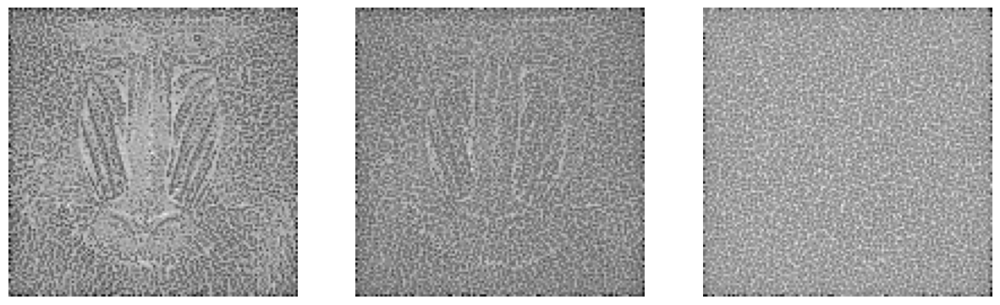

In [76]:
show_filters(knn)
plt.savefig('assets/ivg/baboon_ivg_knn.jpg')

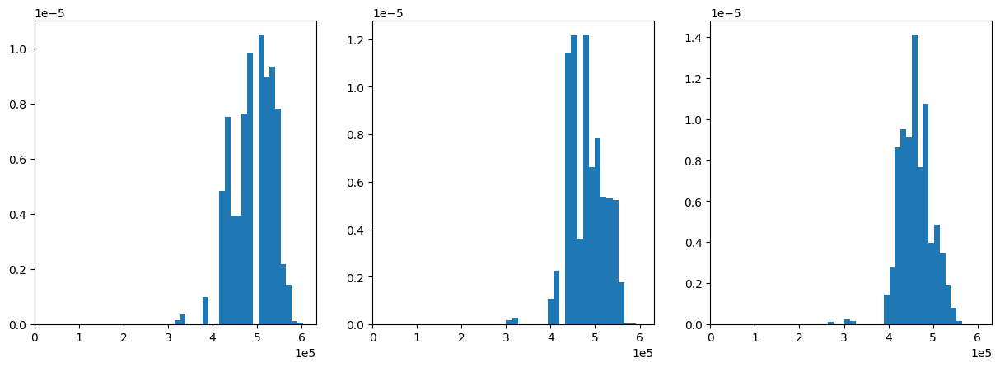

In [77]:
show_knn_hist(knn)
plt.savefig('assets/ivg/baboon_ivg_knn_hist.jpg')

### IHVG

In [78]:
baboon_ihvgs = [IVG(image, horizontal=True) for image in baboon_images]

In [79]:
deg = [degree_matrix(ivg) for ivg in baboon_ihvgs] # grados
clust = [clustering_matrix(ivg) for ivg in baboon_ihvgs] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in baboon_ihvgs] # average nearest-neighbour degree

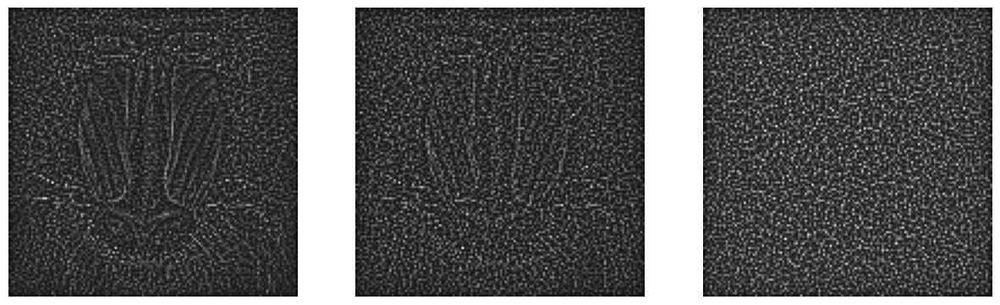

In [80]:
show_filters(deg)
plt.savefig('assets/ivg/baboon_ihvg_deg.jpg')

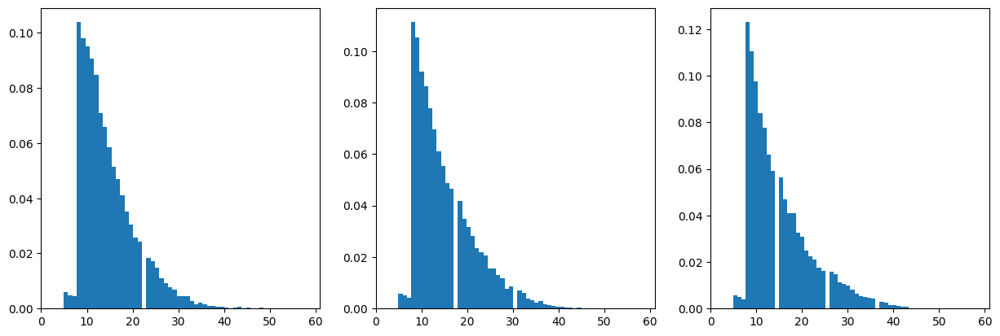

In [81]:
show_deg_hist(deg)
plt.savefig('assets/ivg/baboon_ihvg_deg_hist.jpg')

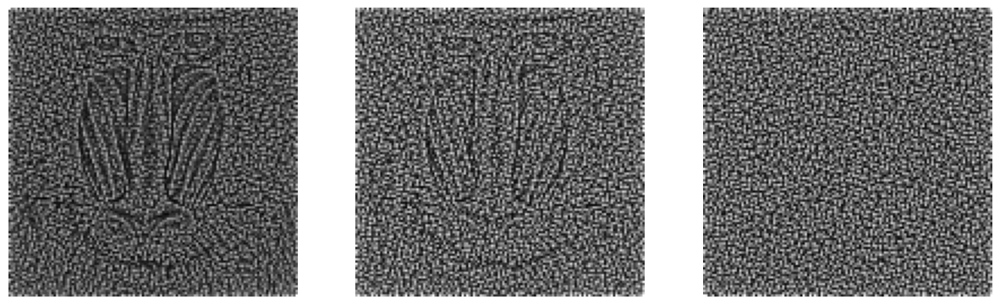

In [82]:
show_filters(clust)
plt.savefig('assets/ivg/baboon_ihvg_clust.jpg')

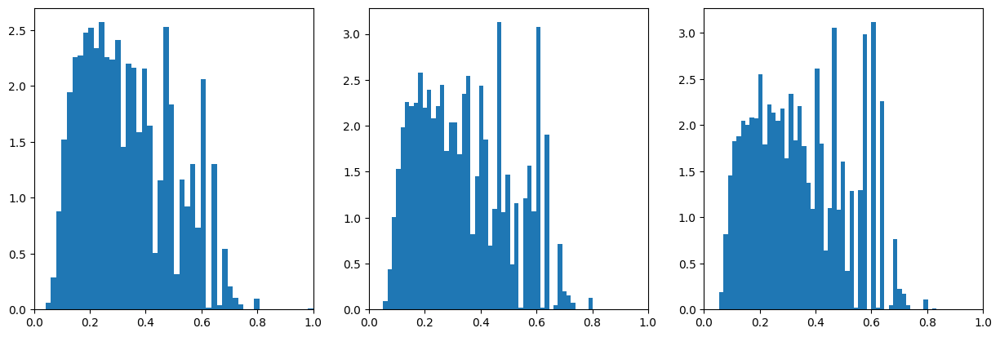

In [83]:
show_clust_hist(clust)
plt.savefig('assets/ivg/baboon_ihvg_clust_hist.jpg')

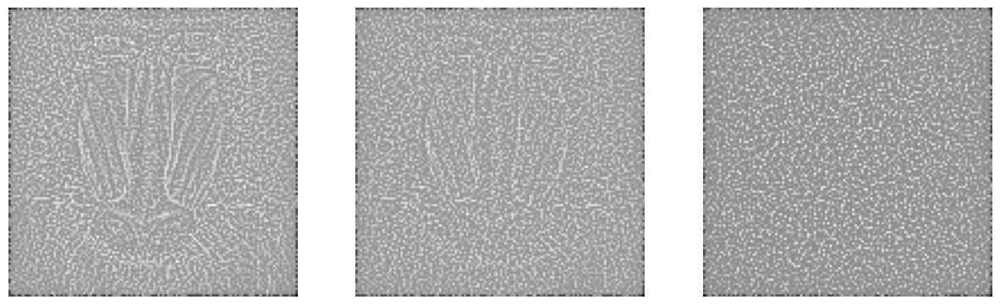

In [84]:
show_filters(knn)
plt.savefig('assets/ivg/baboon_ihvg_knn.jpg')

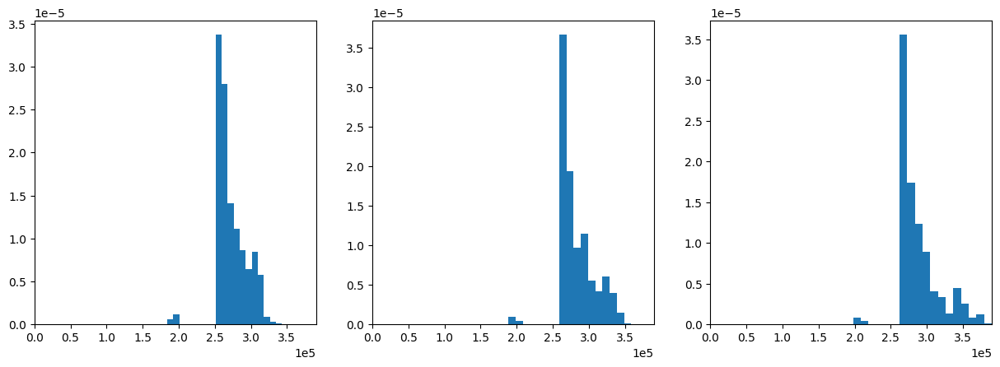

In [85]:
show_knn_hist(knn)
plt.savefig('assets/ivg/baboon_ihvg_knn_hist.jpg')

### IVG diagonales adicionales

In [86]:
baboon_ivgds = [IVG(image, diags=True) for image in baboon_images]

In [87]:
deg = [degree_matrix(ivg) for ivg in baboon_ivgds] # grados
clust = [clustering_matrix(ivg) for ivg in baboon_ivgds] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in baboon_ivgds] # average nearest-neighbour degree

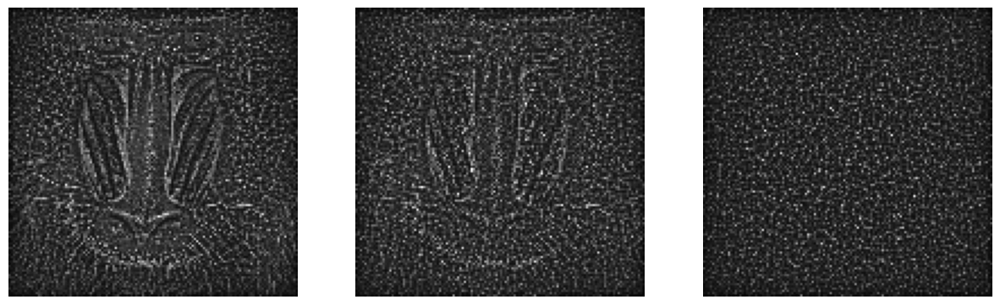

In [88]:
show_filters(deg)
plt.savefig('assets/ivg/baboon_ivgd_deg.jpg')

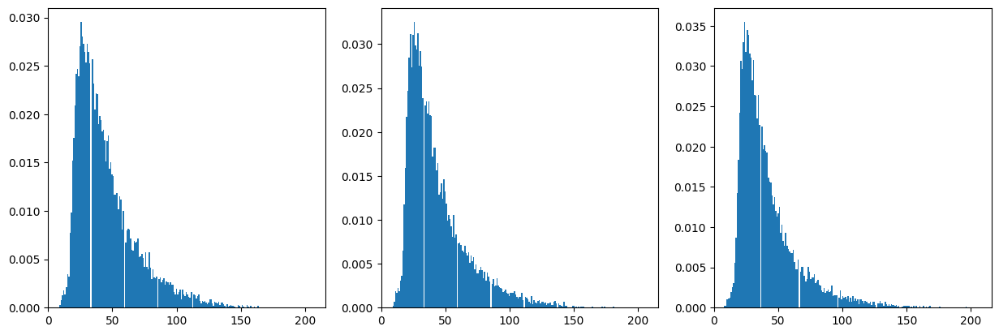

In [89]:
show_deg_hist(deg)
plt.savefig('assets/ivg/baboon_ivgd_deg_hist.jpg')

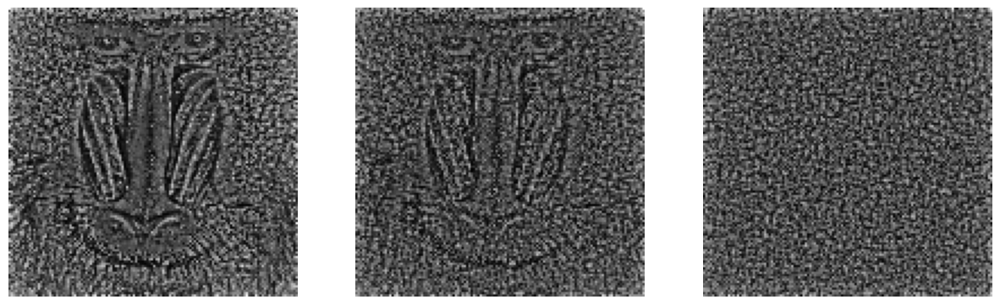

In [90]:
show_filters(clust)
plt.savefig('assets/ivg/baboon_ivgd_clust.jpg')

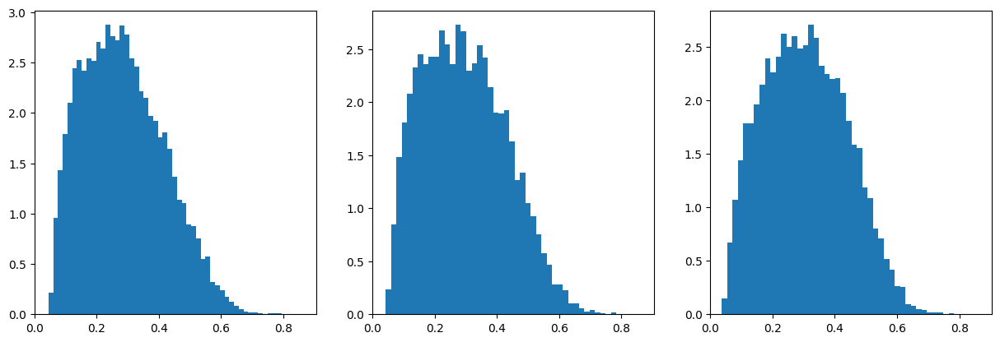

In [91]:
show_clust_hist(clust)
plt.savefig('assets/ivg/baboon_ivgd_clust_hist.jpg')

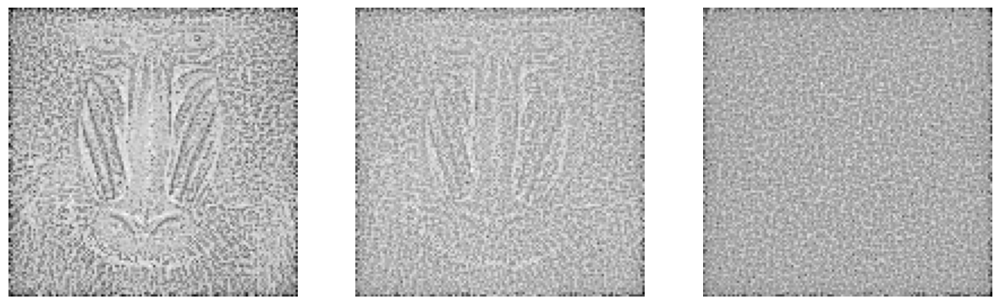

In [92]:
show_filters(knn)
plt.savefig('assets/ivg/baboon_ivgd_knn.jpg')

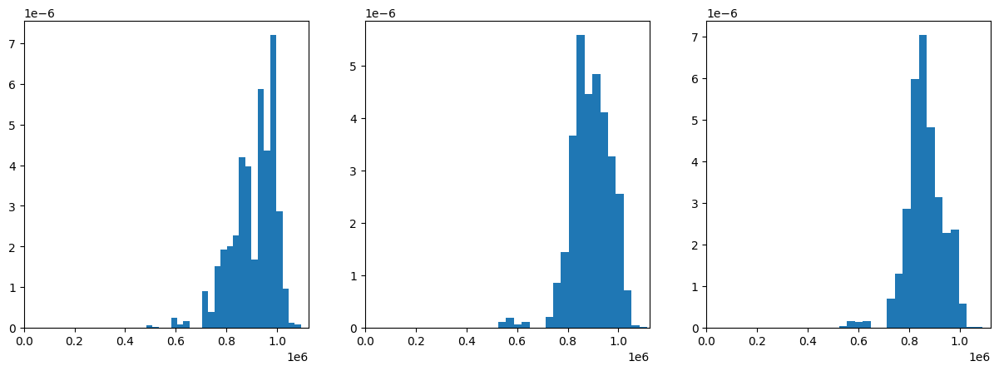

In [93]:
show_knn_hist(knn)
plt.savefig('assets/ivg/baboon_ivgd_knn_hist.jpg')

### IHVG diagonales adicionales

In [94]:
baboon_ihvgds = [IVG(image, horizontal=True, diags=True) for image in baboon_images]

In [95]:
deg = [degree_matrix(ivg) for ivg in baboon_ihvgds] # grados
clust = [clustering_matrix(ivg) for ivg in baboon_ihvgds] # clustering coefficient
knn = [knn_matrix(ivg) for ivg in baboon_ihvgds] # average nearest-neighbour degree

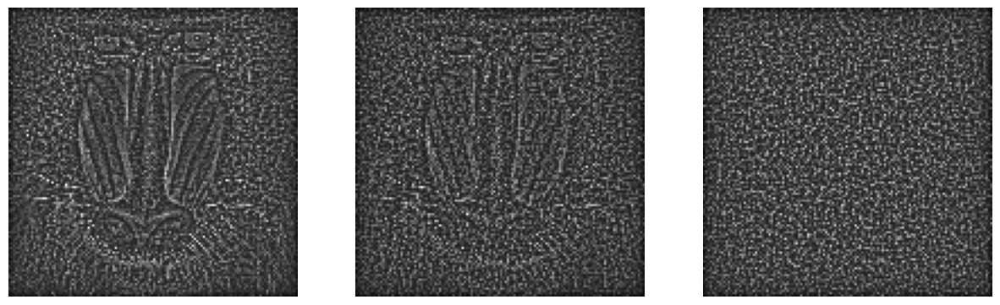

In [96]:
show_filters(deg)
plt.savefig('assets/ivg/baboon_ihvgd_deg.jpg')

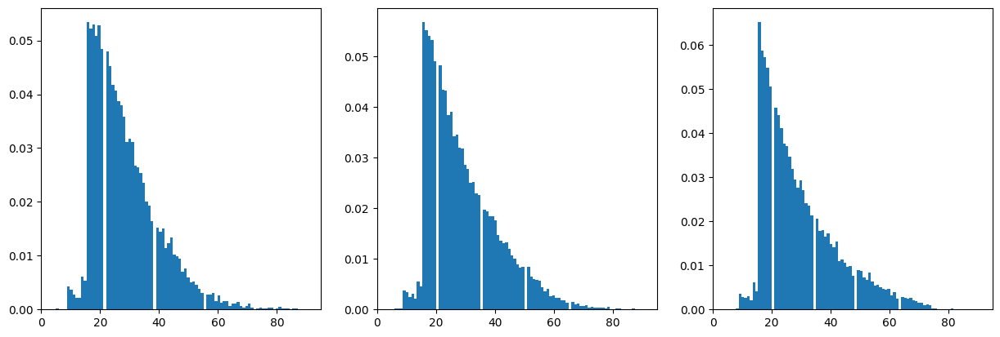

In [97]:
show_deg_hist(deg)
plt.savefig('assets/ivg/baboon_ihvgd_deg_hist.jpg')

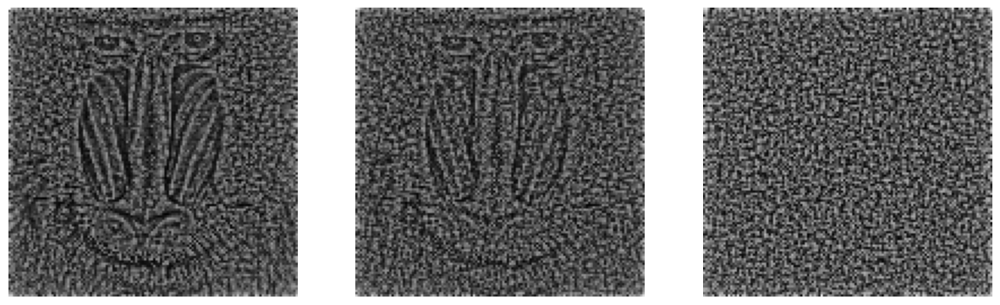

In [98]:
show_filters(clust)
plt.savefig('assets/ivg/baboon_ihvgd_clust.jpg')

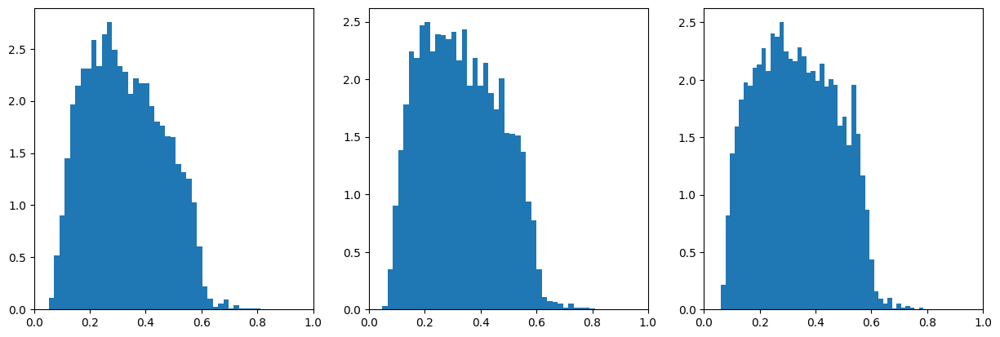

In [99]:
show_clust_hist(clust)
plt.savefig('assets/ivg/baboon_ihvgd_clust_hist.jpg')

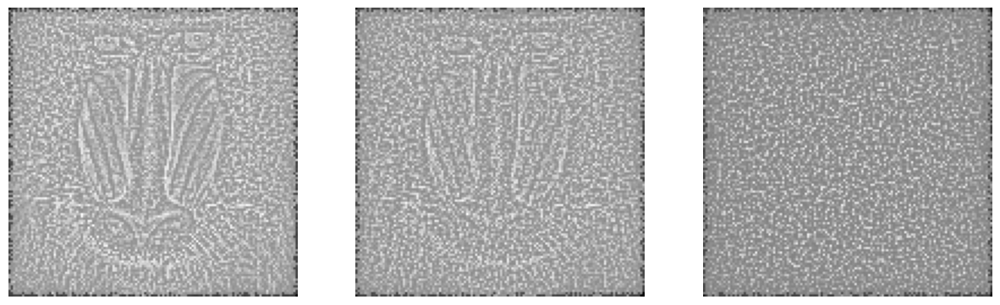

In [100]:
show_filters(knn)
plt.savefig('assets/ivg/baboon_ihvgd_knn.jpg')

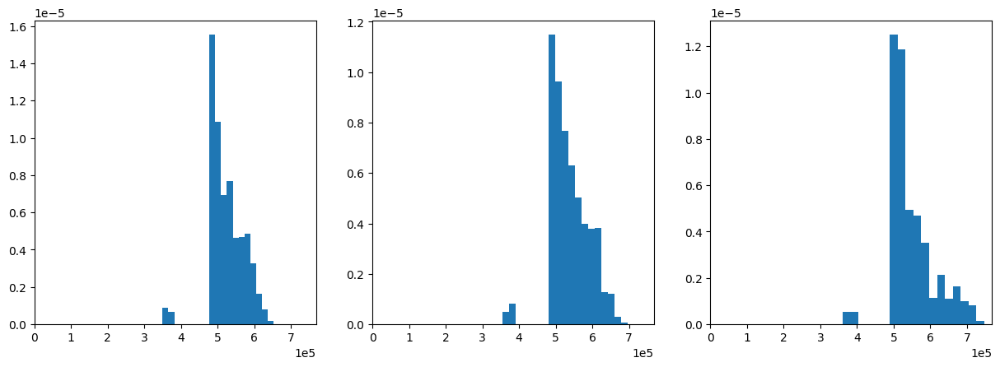

In [101]:
show_knn_hist(knn)
plt.savefig('assets/ivg/baboon_ihvgd_knn_hist.jpg')